In [1]:
import pandas as pd
from pyhive import presto
import getpass
import auth
import psycopg2 as pg
import pandas.io.sql as psql
import pandas_profiling
from datetime import datetime
from datetime import date
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [2]:
import pandas as pd
from pyhive import presto
import getpass
import auth
import psycopg2 as pg
import pandas.io.sql as psql
import pandas_profiling
from datetime import datetime
from datetime import date
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scipy.stats as st
from scipy.stats import pearsonr
from scipy.stats import spearmanr
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn import metrics
import statsmodels.api as sm
%matplotlib inline
from statsmodels.gam.api import GLMGam, BSplines
from statsmodels.gam.tests.test_penalized import df_autos
from patsy import dmatrices
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.formula.api import ols

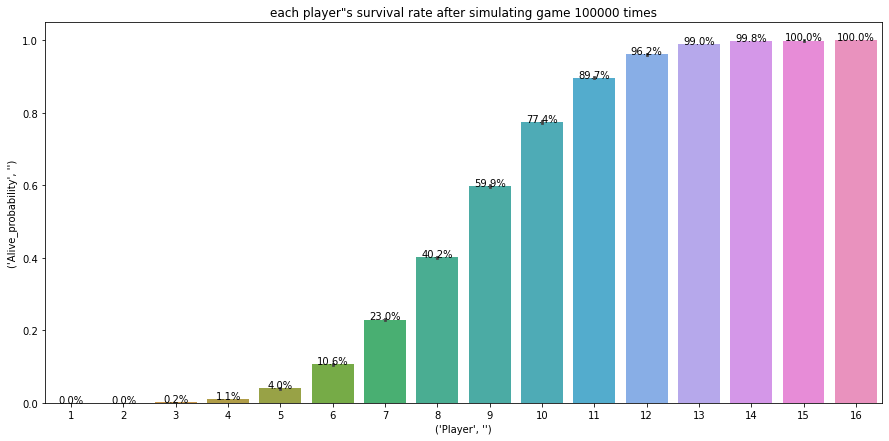

In [3]:
Runs = 100000
Players = 16
Trials = 50
Windows = 16
array1 = np.random.random(size = (Runs,Players,Trials))
a = []
for i in range(1,Runs+1):
    for j in range(1,Players+1):
        a.append((i,j, np.where(array1[i-1,j-1]<0.5)[0][0]))
        
d = pd.DataFrame(a, columns=('Run', 'Player', '#passes'))

d['cum_passes'] = d.groupby('Run')['#passes'].cumsum() + d['Player']-1
d['Result'] = np.where(d['cum_passes']>=Windows,'Alive','Dead')
d['Run_group'] = pd.cut(d['Run'], bins = 10, precision = 0)

d_prob = pd.pivot_table(d, index=['Run_group','Player'], columns = ['Result'], values = ['Run'], aggfunc = 'count', fill_value = 0).reset_index()
d_prob['Alive_probability'] = d_prob[('Run', 'Alive')] / (d_prob[('Run', 'Dead')] + d_prob[('Run', 'Alive')])

d_prob_text = pd.pivot_table(d, index=['Player'], columns = ['Result'], values = ['Run'], aggfunc = 'count', fill_value = 0).reset_index()
d_prob_text['Alive_probability'] = d_prob_text[('Run', 'Alive')] / (d_prob_text[('Run', 'Dead')] + d_prob_text[('Run', 'Alive')])

plt.figure(figsize = (15,7))
plt.title('each player"s survival rate after simulating game 100000 times')
ax = sns.barplot(x =('Player',''), y=('Alive_probability',''), data = d_prob)
for index, row in d_prob_text.iterrows():
    ax.text(row.name,row[('Alive_probability','')], "{:.1%}".format(row[('Alive_probability','')]), color='black', ha="center")


In [4]:
### average number of players who survived after 50K simulation, supports the fact that it's 8.
d_exp = pd.pivot_table(d, index=['Run'], columns = ['Result'], values = ['Player'], aggfunc = 'count', fill_value = 0).reset_index()
d_exp[ ('Player', 'Alive')].mean()

8.00966

In [5]:
d_exp['cumulative_alive'] = d_exp[('Player', 'Alive')].expanding().mean()
d_exp2 = d_exp.set_axis(['Run','Alive','Dead','Cumulative_alive'], axis = 1)


In [6]:
## expected number of players who survived converges to 8 as the simulation played out
iterated = pd.DataFrame()
for  i in range(1,1000):
    iterated = iterated.append(d_exp2.iloc[:i].assign(iterated_row=i))
import plotly.express as px
fig = px.line(iterated, x='Run', y='Cumulative_alive', markers = True
             ## , color="Run"
  ,animation_frame='iterated_row'
              ##,animation_group="country"
              , range_x=[0,1000]
                , range_y =[6,10], title = 'expected # of players survived after games played X times (live progress seen in the first 1000 run)'
             )
fig.show()

In [7]:
## expected number of players who survived converges to 8 as the simulation played out
import plotly.express as px
fig = px.line(d_exp2, x='Run', y='Cumulative_alive'
             ## , color="Run"
  ##,animation_frame='iterated_row'
              ##,animation_group="country"
              , range_x=[0,10000]
                , range_y =[6,10]
              , title = 'expected # of players survived in first 10K runs'
             )
fig.show()